In [ ]:
!pip install tflite-support-nightly
import tflite_support
from tflite_support.metadata_writers import image_classifier
from tflite_support.metadata_writers import writer_utils

import os
import glob
import shutil

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
from tensorflow.keras.preprocessing.image import ImageDataGenerator


import numpy as np
import matplotlib.pyplot as plt

import tensorflow_hub as hub
import tensorflow_datasets as tfds

import logging
logger = tf.get_logger()
logger.setLevel(logging.ERROR)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 42.5 MB 1.4 MB/s 
     |████████████████████████████████| 213 kB 68.8 MB/s 
     |████████████████████████████████| 1.0 MB 48.9 MB/s 
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.17.3
    Uninstalling protobuf-3.17.3:
      Successfully uninstalled protobuf-3.17.3
  Attempting uninstall: flatbuffers
    Found existing installation: flatbuffers 2.0
    Uninstalling flatbuffers-2.0:
      Successfully uninstalled flatbuffers-2.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.8.0+zzzcolab20220506162203 requires tf-estimator-nightly==2.8.0.dev2021122109, which is not installed.


Downloading and preparing dataset

In [ ]:
_URL = 'https://github.com/adamkapus/flower-recognition/archive/refs/heads/master.zip'
zip_file = tf.keras.utils.get_file('flowersdataset', origin=_URL, extract=True)
base_dir = os.path.join(os.path.dirname(zip_file), 'flower-recognition-master','OxforDataSet')

64716800/Unknown - 2s 0us/step

In [ ]:
classes = ['bluebell', 'buttercup', 'colts foot', 'cowslip','crocus', 'daffodil', 'daisy', 'dandelion', 'fritillary','iris', 'lily valley', 'pansy', 'snowdrop', 'sunflower', 'tiger lily',  'tulip',   'windflower',]

In [ ]:
for cl in classes:
  img_path = os.path.join(base_dir, cl)
  images = glob.glob(img_path + '/*.jpg')
  print("{}: {} Images".format(cl, len(images)))
  num_train = int(round(len(images)*0.8))
  train, val = images[:num_train], images[num_train:]

  for t in train:
    if not os.path.exists(os.path.join(base_dir, 'train', cl)):
      os.makedirs(os.path.join(base_dir, 'train', cl))
    shutil.move(t, os.path.join(base_dir, 'train', cl))

  for v in val:
    if not os.path.exists(os.path.join(base_dir, 'val', cl)):
      os.makedirs(os.path.join(base_dir, 'val', cl))
    shutil.move(v, os.path.join(base_dir, 'val', cl))

bluebell: 80 Images
buttercup: 80 Images
colts foot: 80 Images
cowslip: 80 Images
crocus: 80 Images
daffodil: 80 Images
daisy: 80 Images
dandelion: 80 Images
fritillary: 80 Images
iris: 80 Images
lily valley: 80 Images
pansy: 80 Images
snowdrop: 80 Images
sunflower: 80 Images
tiger lily: 80 Images
tulip: 80 Images
windflower: 80 Images


In [ ]:
train_dir = os.path.join(base_dir, 'train')
val_dir = os.path.join(base_dir, 'val')

In [ ]:
batch_size = 100
IMG_SHAPE = 224

In [ ]:
image_gen_train = ImageDataGenerator(
                    rescale=1./255,
                    rotation_range=45,
                    width_shift_range=.15,
                    height_shift_range=.15,
                    horizontal_flip=True,
                    zoom_range=0.5
                    )


train_data_gen = image_gen_train.flow_from_directory(
                                                batch_size=batch_size,
                                                directory=train_dir,
                                                shuffle=True,
                                                target_size=(IMG_SHAPE,IMG_SHAPE),
                                                class_mode='sparse'
                                                )

Found 1088 images belonging to 17 classes.


In [ ]:
image_gen_val = ImageDataGenerator(rescale=1./255)

val_data_gen = image_gen_val.flow_from_directory(batch_size=batch_size,
                                                 directory=val_dir,
                                                 shuffle=False,
                                                 target_size=(IMG_SHAPE, IMG_SHAPE),
                                                 class_mode='sparse')

Found 272 images belonging to 17 classes.


Viewing images from dataset

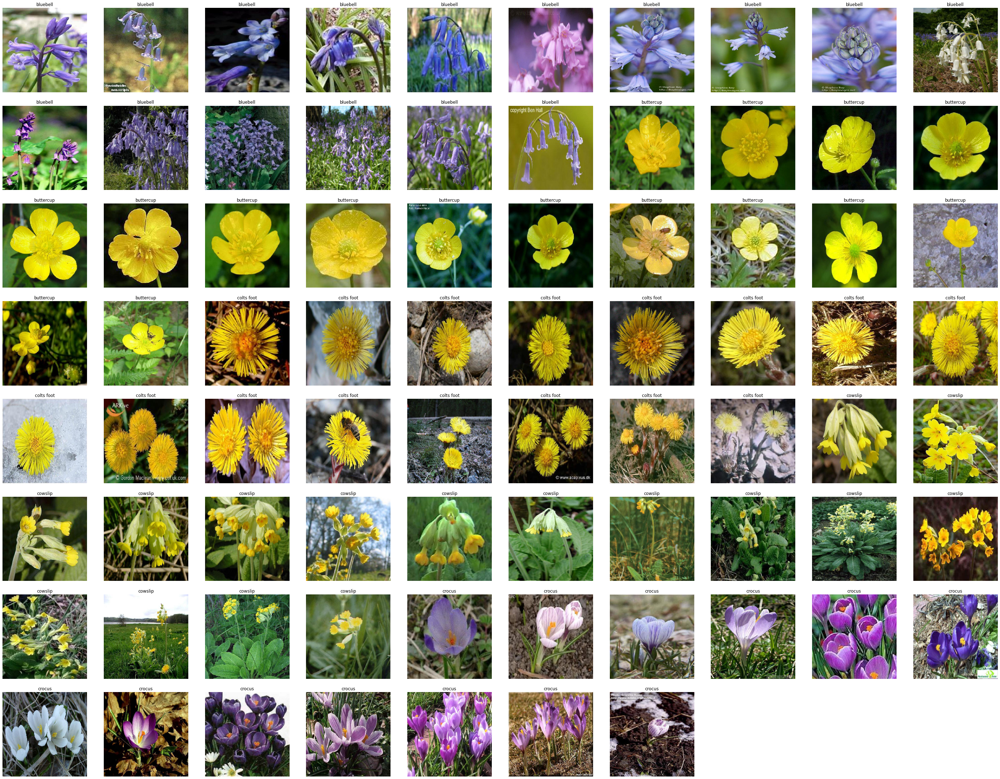

In [ ]:
images, labels = val_data_gen.next()
#print(labels)
plt.figure(figsize=(50,50))
for i in range(77):
  ax = plt.subplot(10, 10, i + 1)
  plt.subplots_adjust(hspace = 0.1)
  plt.imshow(images[i])
  plt.title(classes[labels[i].astype(int)])
  plt.axis("off")


Transfer learning

In [ ]:
num_classes = len(classes)

In [ ]:
URL = "https://tfhub.dev/google/tf2-preview/mobilenet_v2/feature_vector/4"
feature_extractor = hub.KerasLayer(URL,
                                   input_shape=(IMG_SHAPE, IMG_SHAPE, 3))

feature_extractor.trainable = False

In [ ]:
model = tf.keras.Sequential([
  feature_extractor,
  layers.Dense(num_classes, activation='softmax')
])

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1280)              2257984   
                                                                 
 dense (Dense)               (None, 17)                21777     
                                                                 
Total params: 2,279,761
Trainable params: 21,777
Non-trainable params: 2,257,984
_________________________________________________________________


In [ ]:
model.compile(
  optimizer='adam',
  loss=tf.keras.losses.SparseCategoricalCrossentropy(),
  metrics=['accuracy'])

In [ ]:
epochs = 30

history = model.fit_generator(
    train_data_gen,
    steps_per_epoch=int(np.ceil(train_data_gen.n / float(batch_size))),
    epochs=epochs,
    validation_data=val_data_gen,
    validation_steps=int(np.ceil(val_data_gen.n / float(batch_size)))
)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  


Epoch 1/30
11/11 [==============================] - 32s 2s/step - loss: 2.7588 - accuracy: 0.1553 - val_loss: 2.1126 - val_accuracy: 0.3713
Epoch 2/30
11/11 [==============================] - 18s 2s/step - loss: 1.7507 - accuracy: 0.5110 - val_loss: 1.4295 - val_accuracy: 0.6213
Epoch 3/30
11/11 [==============================] - 18s 2s/step - loss: 1.1844 - accuracy: 0.6976 - val_loss: 1.0395 - val_accuracy: 0.7610
Epoch 4/30
11/11 [==============================] - 19s 2s/step - loss: 0.8924 - accuracy: 0.7721 - val_loss: 0.8384 - val_accuracy: 0.7831
Epoch 5/30
11/11 [==============================] - 18s 2s/step - loss: 0.7414 - accuracy: 0.8171 - val_loss: 0.6957 - val_accuracy: 0.8235
Epoch 6/30
11/11 [==============================] - 18s 2s/step - loss: 0.6434 - accuracy: 0.8447 - val_loss: 0.6125 - val_accuracy: 0.8382
Epoch 7/30
11/11 [==============================] - 18s 2s/step - loss: 0.5532 - accuracy: 0.8713 - val_loss: 0.5557 - val_accuracy: 0.8713
Epoch 8/30
11/11 [==

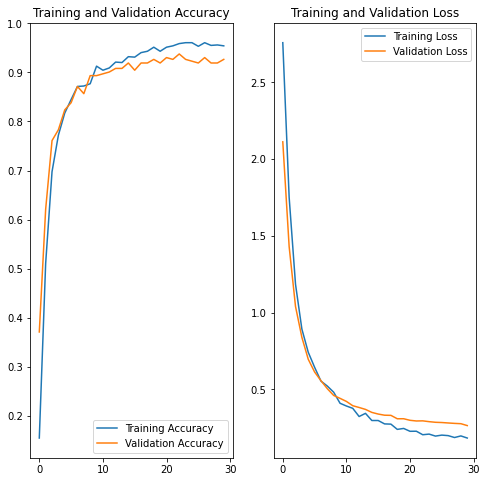

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

Looking at the predictions

In [ ]:
image_batch, label_batch = val_data_gen.next()
predicted_batch = model.predict(image_batch)

predicted_batch = tf.squeeze(predicted_batch).numpy()
predicted_ids = np.argmax(predicted_batch, axis=-1)

class_names = np.array(classes)
predicted_class_names = class_names[predicted_ids]

In [ ]:
#print("Labels:           ", label_batch)
#print("Predicted labels: ", predicted_ids)

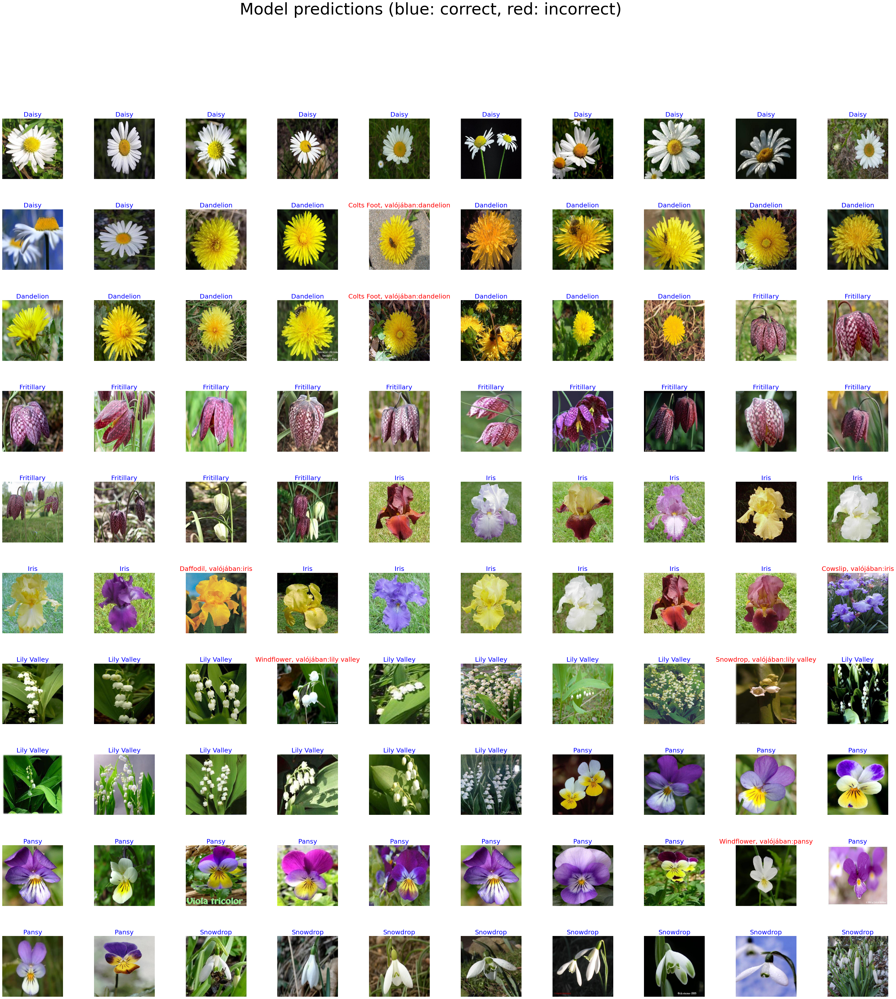

In [ ]:
plt.figure(figsize=(50,50))
for n in range(100):
  plt.subplot(10,10,n+1)
  plt.subplots_adjust(hspace = 0.5)
  plt.imshow(image_batch[n])
  color = "blue" if predicted_ids[n] == label_batch[n] else "red"
  text = predicted_class_names[n].title() if predicted_ids[n] == label_batch[n] else  predicted_class_names[n].title() + ", valójában:" + classes[label_batch[n].astype(int)]
  plt.title(text, color=color, fontsize=20)
  plt.axis('off')
_ = plt.suptitle("Model predictions (blue: correct, red: incorrect)", fontsize=50)

Saving and converting the model to TF Lite

In [ ]:
FLOWERS_MODEL = "exp_saved_model"

In [ ]:
tf.saved_model.save(model, FLOWERS_MODEL)

In [ ]:
%%bash -s $FLOWERS_MODEL
saved_model_cli show --dir $1 --tag_set serve --signature_def serving_default

The given SavedModel SignatureDef contains the following input(s):
  inputs['keras_layer_input'] tensor_info:
      dtype: DT_FLOAT
      shape: (-1, 224, 224, 3)
      name: serving_default_keras_layer_input:0
The given SavedModel SignatureDef contains the following output(s):
  outputs['dense'] tensor_info:
      dtype: DT_FLOAT
      shape: (-1, 17)
      name: StatefulPartitionedCall:0
Method name is: tensorflow/serving/predict


In [ ]:
converter = tf.lite.TFLiteConverter.from_saved_model(FLOWERS_MODEL)

In [ ]:
converter.optimizations = [tf.lite.Optimize.DEFAULT]
#converter.target_spec.supported_ops = [tf.lite.OpsSet.TFLITE_BUILTINS_INT8]
#converter.inference_input_type = tf.int8  # or tf.uint8
#converter.inference_output_type = tf.int8  # or tf.uint8

In [ ]:
tflite_model = converter.convert()
tflite_model_file = 'converted_model.tflite'

with open(tflite_model_file, "wb") as f:
  f.write(tflite_model)

In [ ]:
labels = classes

with open('labels.txt', 'w') as f:
  f.write('\n'.join(labels))

try:
  from google.colab import files
  files.download('converted_model.tflite')
  files.download('labels.txt')
except:
  pass

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Testing the converted model

In [ ]:
# Load TFLite model and allocate tensors.
interpreter = tf.lite.Interpreter(model_content=tflite_model)
interpreter.allocate_tensors()

input_index = interpreter.get_input_details()[0]["index"]
output_index = interpreter.get_output_details()[0]["index"]

In [ ]:
# Gather results for the randomly sampled test images
predictions = []
test_labels = []
test_images = []

image_batch, label_batch = val_data_gen.next()
for i in range(50):
  interpreter.set_tensor(input_index, tf.expand_dims(image_batch[i], axis=0))
  interpreter.invoke()
  predictions.append(interpreter.get_tensor(output_index))
  test_labels.append(label_batch[i])
  test_images.append(np.array(image_batch[i]))

#print(predictions)




[array([[2.5241408e-03, 5.2027073e-04, 6.3037583e-06, 4.4971476e-03,
        1.5688187e-02, 2.4098832e-04, 1.3447467e-05, 4.4485450e-06,
        5.5560539e-04, 8.3181803e-05, 1.9390299e-03, 1.9389947e-05,
        9.6147215e-01, 3.8256221e-06, 2.4936870e-03, 9.0858182e-03,
        8.5224648e-04]], dtype=float32), array([[1.0714249e-02, 8.0994014e-06, 1.3537751e-05, 1.2184371e-04,
        2.8976114e-04, 1.0675383e-04, 4.3371728e-07, 2.9686087e-05,
        1.8274126e-03, 2.0082149e-05, 2.1616642e-03, 1.6765984e-05,
        9.8368394e-01, 8.4920184e-06, 6.9192925e-04, 2.9254693e-04,
        1.2774439e-05]], dtype=float32), array([[1.8518558e-05, 3.6339930e-05, 1.8984292e-05, 6.1017341e-05,
        1.4970772e-04, 1.0292401e-03, 2.9671032e-06, 4.6563482e-06,
        7.1324635e-04, 5.1722898e-05, 7.3173660e-04, 6.1205348e-05,
        9.9334645e-01, 5.1938982e-06, 1.8221284e-05, 6.7583728e-04,
        3.0749231e-03]], dtype=float32), array([[8.5622371e-05, 2.2750968e-04, 9.2988613e-04, 7.60513

In [ ]:
#@title Utility functions for plotting
# Utilities for plotting

def plot_image(i, predictions_array, true_label, img):
  predictions_array, true_label, img = predictions_array[i], true_label[i], img[i]
  plt.grid(False)
  plt.xticks([])
  plt.yticks([])
  
  img = np.squeeze(img)

  plt.imshow(img, cmap=plt.cm.binary)

  predicted_label = np.argmax(predictions_array)
  if predicted_label == true_label:
    color = 'green'
  else:
    color = 'red'
    
  plt.xlabel("{} {:2.0f}% ({})".format(class_names[predicted_label],
                                100*np.max(predictions_array),
                                class_names[true_label.astype(int)]),
                                color=color)

def plot_value_array(i, predictions_array, true_label):
  predictions_array, true_label = predictions_array[i], true_label[i]
  plt.grid(False)
  plt.xticks(list(range(10)), class_names, rotation='vertical')
  plt.yticks([])
  thisplot = plt.bar(range(10), predictions_array[0], color="#777777")
  plt.ylim([0, 1])
  predicted_label = np.argmax(predictions_array[0])

  thisplot[predicted_label].set_color('red')
  thisplot[true_label].set_color('green')

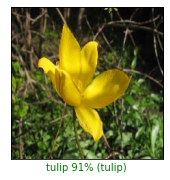

In [ ]:
#@title Visualize the outputs { run: "auto" }
index = 45 #@param {type:"slider", min:1, max:50, step:1}
plt.figure(figsize=(6,3))
plt.subplot(1,2,1)
plot_image(index, predictions, test_labels, test_images)
plt.show()
#plot_value_array(index, predictions, test_labels)
plt.show()

Adding Metadata to the TFLite modell




In [ ]:
ImageClassifierWriter = image_classifier.MetadataWriter
_MODEL_PATH = 'converted_model.tflite'
_LABEL_FILE = 'labels.txt'
_SAVE_TO_PATH = "conv-mod-meta.tflite"
_INPUT_NORM_MEAN = 127.5
_INPUT_NORM_STD = 127.5

# Create the metadata writer.
writer = ImageClassifierWriter.create_for_inference(
    writer_utils.load_file(_MODEL_PATH), [_INPUT_NORM_MEAN], [_INPUT_NORM_STD],
    [_LABEL_FILE])


# Verify the metadata generated by metadata writer.
print(writer.get_metadata_json())

# Populate the metadata into the model.
writer_utils.save_file(writer.populate(), _SAVE_TO_PATH)

try:
  from google.colab import files
  files.download("conv-mod-meta.tflite")
except:
  pass


{
  "name": "ImageClassifier",
  "description": "Identify the most prominent object in the image from a known set of categories.",
  "subgraph_metadata": [
    {
      "input_tensor_metadata": [
        {
          "name": "image",
          "description": "Input image to be classified.",
          "content": {
            "content_properties_type": "ImageProperties",
            "content_properties": {
              "color_space": "RGB"
            }
          },
          "process_units": [
            {
              "options_type": "NormalizationOptions",
              "options": {
                "mean": [
                  127.5
                ],
                "std": [
                  127.5
                ]
              }
            }
          ],
          "stats": {
            "max": [
              1.0
            ],
            "min": [
              -1.0
            ]
          }
        }
      ],
      "output_tensor_metadata": [
        {
          "name": "proba

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>